# **Operações na Média vs Aleatório**

## ***Explicação***

Objetivo desse estudo é analisar uma tendência de alta e identificar se candles seguintes ao candle que toca na média móvel (20) tem maior probabilidade de ser positivo em relação aos demais candles acima da média mas que não tocam nela.

**Premissas para uma tendência:**

- Ter pelo menos 3 candles completamente acima da média móvel de 20;
- A média móvel de 20 períodos estar acima da média móvel de 60 períodos (20 do 15m)
- A média móvel de 60 estar acima da média móvel de 200 períodos.

**Premissas para toque na média:**
- Candle anterior estar em tendência
- Candle do toque ter mínima menor ou igual à média e close maior que a média

## ***Importando Bibliotecas***

In [74]:
import pandas as pd
import yfinance as yf
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from datetime import datetime

## ***Importando Dados do ativo via yfinance***

In [2]:
dados = yf.download('AAPL', period='max', interval='1D')
dados.head()

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
1980-12-12,0.128348,0.128906,0.128348,0.128348,0.099722,469033600
1980-12-15,0.122210,0.122210,0.121652,0.121652,0.094519,175884800
1980-12-16,0.113281,0.113281,0.112723,0.112723,0.087582,105728000
1980-12-17,0.115513,0.116071,0.115513,0.115513,0.089749,86441600
1980-12-18,0.118862,0.119420,0.118862,0.118862,0.092351,73449600


## ***Criar médias médias móveis necessárias para o estudo:***

In [3]:
media_principal = 20
media_15m = 60 # 20 * 3
media_1hr = 240 # 20 * 12
dados['Media_Principal'] = dados['Close'].rolling(media_principal).mean()
dados['Media_15m'] = dados['Close'].rolling(media_15m).mean()
dados['Media_1hr'] = dados['Close'].rolling(media_1hr).mean()
dados

,Open,High,Low,Close,Adj Close,Volume,Media_Principal,Media_15m,Media_1hr
Date,,,,,,,,,
1980-12-12,0.128348,0.128906,0.128348,0.128348,0.099722,469033600,NaN,NaN,NaN
1980-12-15,0.122210,0.122210,0.121652,0.121652,0.094519,175884800,NaN,NaN,NaN
1980-12-16,0.113281,0.113281,0.112723,0.112723,0.087582,105728000,NaN,NaN,NaN
1980-12-17,0.115513,0.116071,0.115513,0.115513,0.089749,86441600,NaN,NaN,NaN
1980-12-18,0.118862,0.119420,0.118862,0.118862,0.092351,73449600,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
2023-02-15,153.110001,155.500000,152.880005,155.330002,155.330002,65669300,147.456499,141.106333,150.552083
2023-02-16,153.509995,156.330002,153.350006,153.710007,153.710007,68167900,148.378499,141.146666,150.512666
2023-02-17,152.350006,153.000000,150.850006,152.550003,152.550003,59095900,149.112499,141.222333,150.484541


## ***Criar condições para tendência com def (forma 01):***

In [6]:
def cond_tendencia(df):
    if df['Low'].shift(2) > df['media_principal'].shift(2) and df['Low'].shift(1) > df['media_principal'].shift(1) and df['Low'] > df['media_principal'] and df['media_principal'] > df['media_15m'] and df['media_15m'] > df['media_1hr']:
        return True
    else:
        return False    

In [9]:
dados['tendencia'] = dados.apply(cond_tendencia, axis=1)

In [16]:
dados.head()

,Open,High,Low,Close,Adj Close,Volume,media_principal,media_15m,media_1hr,tendencia
Date,,,,,,,,,,
2005-01-03,26193.0,26492.0,25671.0,25722.0,25722.0,0,NaN,NaN,NaN,False
2005-01-04,25722.0,25873.0,24791.0,24848.0,24848.0,0,NaN,NaN,NaN,False
2005-01-05,24859.0,25001.0,24523.0,24692.0,24692.0,0,NaN,NaN,NaN,False
2005-01-06,24695.0,24808.0,24250.0,24367.0,24367.0,0,NaN,NaN,NaN,False
2005-01-07,24376.0,24874.0,24376.0,24747.0,24747.0,0,NaN,NaN,NaN,False


In [17]:
dados.loc['2022-10-01':'2022-10-28']

,Open,High,Low,Close,Adj Close,Volume,media_principal,media_15m,media_1hr,tendencia
Date,,,,,,,,,,
2022-10-03,110048.0,116134.0,110048.0,116134.0,116134.0,20982900,111000.20,107639.650000,108268.058333,False
2022-10-04,116704.0,118280.0,115837.0,116230.0,116230.0,16078700,111201.55,107939.950000,108291.212500,False
2022-10-05,116231.0,117514.0,115906.0,117198.0,117198.0,13555200,111573.25,108255.400000,108317.929167,False
2022-10-06,117200.0,118382.0,117144.0,117561.0,117561.0,14520500,111955.50,108583.400000,108358.870833,True
2022-10-07,117560.0,117960.0,115924.0,116375.0,116375.0,13616500,112159.25,108920.966667,108400.866667,True
2022-10-10,116377.0,116841.0,115261.0,115941.0,115941.0,11429900,112285.95,109244.133333,108430.975000,True
2022-10-11,115928.0,115928.0,114297.0,114827.0,114827.0,13137900,112487.60,109542.650000,108466.004167,True
2022-10-13,114819.0,115367.0,112690.0,114300.0,114300.0,14583700,112675.25,109810.233333,108499.075000,True
2022-10-14,114301.0,114712.0,111631.0,112072.0,112072.0,13096100,112781.15,110039.983333,108525.604167,False


### Testar tendencia com def

In [14]:
dados.loc['2022-10-01':'2022-10-28']

,Open,High,Low,Close,Adj Close,Volume,media_principal,media_15m,media_1hr,tendencia
Date,,,,,,,,,,
2022-10-03,110048.0,116134.0,110048.0,116134.0,116134.0,20982900,111000.20,107639.650000,108268.058333,False
2022-10-04,116704.0,118280.0,115837.0,116230.0,116230.0,16078700,111201.55,107939.950000,108291.212500,False
2022-10-05,116231.0,117514.0,115906.0,117198.0,117198.0,13555200,111573.25,108255.400000,108317.929167,False
2022-10-06,117200.0,118382.0,117144.0,117561.0,117561.0,14520500,111955.50,108583.400000,108358.870833,True
2022-10-07,117560.0,117960.0,115924.0,116375.0,116375.0,13616500,112159.25,108920.966667,108400.866667,True
2022-10-10,116377.0,116841.0,115261.0,115941.0,115941.0,11429900,112285.95,109244.133333,108430.975000,True
2022-10-11,115928.0,115928.0,114297.0,114827.0,114827.0,13137900,112487.60,109542.650000,108466.004167,True
2022-10-13,114819.0,115367.0,112690.0,114300.0,114300.0,14583700,112675.25,109810.233333,108499.075000,True
2022-10-14,114301.0,114712.0,111631.0,112072.0,112072.0,13096100,112781.15,110039.983333,108525.604167,False


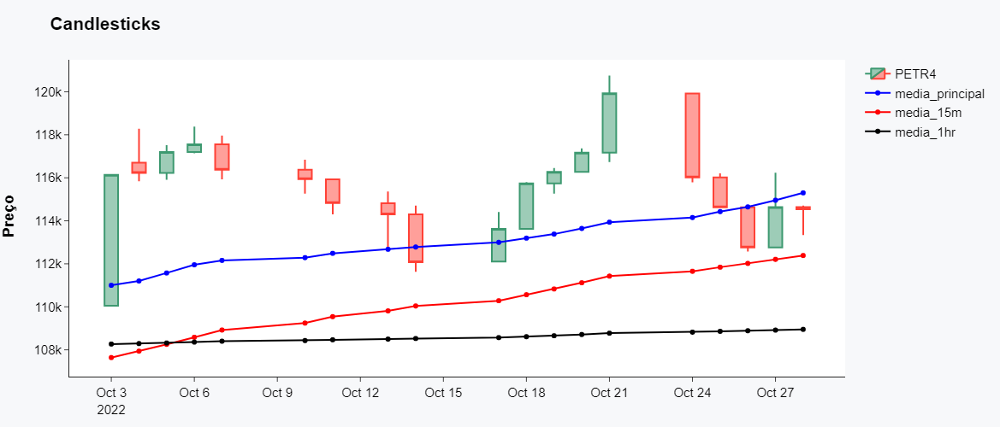

In [15]:
df_figure = dados.loc['2022-10-01':'2022-10-28']
fig = make_subplots(rows=1, cols=1)

fig.add_trace(go.Candlestick(name='PETR4', x=df_figure.index, open=df_figure['Open'], high = df_figure['High'], 
                             low=df_figure['Low'], close=df_figure['Close']), row=1,col=1)

fig.add_trace(go.Scatter(name='media_principal', x=df_figure.index, y=df_figure['media_principal'], marker_color='blue'), row=1, col=1)
fig.add_trace(go.Scatter(name='media_15m', x=df_figure.index, y=df_figure['media_15m'], marker_color='red'), row=1, col=1)
fig.add_trace(go.Scatter(name='media_1hr', x=df_figure.index, y=df_figure['media_1hr'], marker_color='black'), row=1, col=1)


#fig.update_xaxes(title_text="<b> Data",rangebreaks=[dict(bounds=["sat", "mon"])])
fig.update_layout(xaxis_rangeslider_visible=False, title_text='<b>Candlesticks', 
                  yaxis1_title="<b> Preço",
                  font=dict(family="Arial", size=15, color="black"), margin=dict(l=50, r=20, t=70, b=20),
                  template = 'simple_white', paper_bgcolor="#f7f8fa",
                  width=800, height=500)
fig.show()

## ***Criar condições para tendência com def (forma 02):***

In [4]:
dados['Low_Shift_1'] = dados['Low'].shift(1)
dados['Low_Shift_2'] = dados['Low'].shift(2)
dados['Media_Principal_Shift_1'] = dados['Media_Principal'].shift(1)
dados['Media_Principal_Shift_2'] = dados['Media_Principal'].shift(2)

In [5]:
def cond_tendencia(df):
    if df['Low_Shift_2'] > df['Media_Principal_Shift_2'] and df['Low_Shift_1'] > df['Media_Principal_Shift_1'] and df['Low'] > df['Media_Principal'] and df['Media_Principal'] > df['Media_15m'] and df['Media_15m'] > df['Media_1hr']:
        return True
    else:
        return False   

dados['Tendencia'] = dados.apply(cond_tendencia, axis=1)
dados.tail()

,Open,High,Low,Close,Adj Close,Volume,Media_Principal,Media_15m,Media_1hr,Low_Shift_1,Low_Shift_2,Media_Principal_Shift_1,Media_Principal_Shift_2,Tendencia
Date,,,,,,,,,,,,,,
2023-02-15,153.110001,155.500000,152.880005,155.330002,155.330002,65669300,147.456499,141.106333,150.552083,150.860001,150.919998,146.450499,145.587499,False
2023-02-16,153.509995,156.330002,153.350006,153.710007,153.710007,68167900,148.378499,141.146666,150.512666,152.880005,150.860001,147.456499,146.450499,False
2023-02-17,152.350006,153.000000,150.850006,152.550003,152.550003,59095900,149.112499,141.222333,150.484541,153.350006,152.880005,148.378499,147.456499,False
2023-02-21,150.199997,151.300003,148.410004,148.479996,148.479996,58867200,149.480999,141.194000,150.447208,150.850006,153.350006,149.112499,148.378499,False
2023-02-22,148.869995,149.949997,147.160004,148.910004,148.910004,51011305,149.799999,141.158000,150.388708,148.410004,150.850006,149.480999,149.112499,False


### ***Plotando***

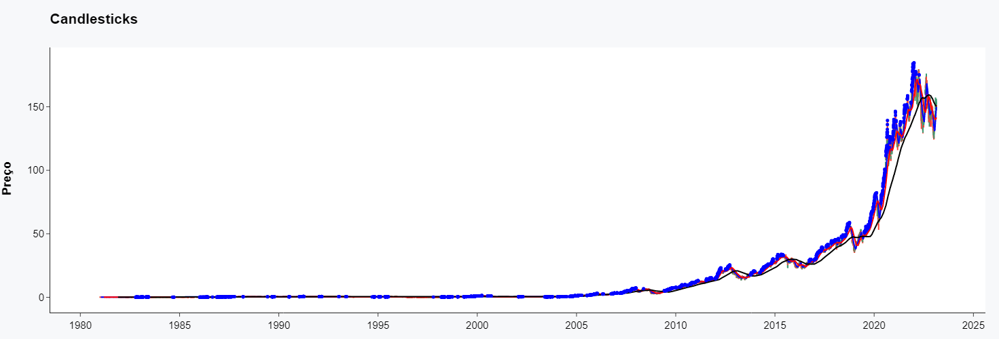

In [6]:
df_figure = dados
fig = make_subplots(rows=1, cols=1)

fig.add_trace(go.Candlestick(name='PETR4', x=df_figure.index, open=df_figure['Open'], high = df_figure['High'], 
                             low=df_figure['Low'], close=df_figure['Close']), row=1,col=1)

fig.add_trace(go.Scatter(name='media_principal', x=df_figure.index, y=df_figure['Media_Principal'], marker_color='blue'), row=1, col=1)
fig.add_trace(go.Scatter(name='media_15m', x=df_figure.index, y=df_figure['Media_15m'], marker_color='red'), row=1, col=1)
fig.add_trace(go.Scatter(name='media_1hr', x=df_figure.index, y=df_figure['Media_1hr'], marker_color='black'), row=1, col=1)
fig.add_trace(go.Scatter(name='tendencia', x=df_figure.index, y=(1 + .009)*df_figure["High"].where(df_figure["Tendencia"] == True), 
mode='markers', marker=dict(color='Blue', size=5)))


#fig.update_xaxes(title_text="<b> Data",rangebreaks=[dict(bounds=["sat", "mon"])])
fig.update_layout(xaxis_rangeslider_visible=False, showlegend=False)
fig.update_layout(xaxis_rangeslider_visible=False, title_text='<b>Candlesticks', 
                  yaxis1_title="<b> Preço",
                  font=dict(family="Arial", size=15, color="black"), margin=dict(l=50, r=20, t=70, b=20),
                  template = 'simple_white', paper_bgcolor="#f7f8fa",
                  width=800, height=500)
fig.show()

## ***Criar condições tendência usando o for (forma 03)***

In [30]:
resultados = []
for index, row in dados.iterrows():
    if row['Low'].shift(2) > row['media_principal'].shift(2) and row['Low'].shift(1) > row['media_principal'].shift(1) and row['Low'] > row['media_principal'] and row['media_principal'] > row['media_15m'] and row['media_15m'] > row['media_1hr']:
        resultados.append(True)
    else:
        resultados.append(False)
    

AttributeError: 'numpy.float64' object has no attribute 'shift'

### Testar candles abaixo da media

In [57]:
df_figure = dados.loc[dados['abaixo_media'] == True]
fig = make_subplots(rows=1, cols=1)

fig.add_trace(go.Candlestick(name='PETR4', x=df_figure.index, open=df_figure['Open'], high = df_figure['High'], 
                             low=df_figure['Low'], close=df_figure['Close']), row=1,col=1)

fig.add_trace(go.Scatter(name='MM_20', x=df_figure.index, y=df_figure['mm20'], marker_color='black'), row=1, col=1)


#fig.update_xaxes(title_text="<b> Data",rangebreaks=[dict(bounds=["sat", "mon"])])
fig.update_layout(xaxis_rangeslider_visible=False, title_text='<b>Candlesticks', 
                  yaxis1_title="<b> Preço",
                  font=dict(family="Arial", size=15, color="black"), margin=dict(l=50, r=20, t=70, b=20),
                  template = 'simple_white', paper_bgcolor="#f7f8fa",
                  width=800, height=500)
fig.show()

### Testar candles que tocam na media

In [58]:
df_figure = dados.loc[dados['toca_media'] == True]
fig = make_subplots(rows=1, cols=1)

fig.add_trace(go.Candlestick(name='PETR4', x=df_figure.index, open=df_figure['Open'], high = df_figure['High'], 
                             low=df_figure['Low'], close=df_figure['Close']), row=1,col=1)

fig.add_trace(go.Scatter(name='MM_20', x=df_figure.index, y=df_figure['mm20'], marker_color='black'), row=1, col=1)


#fig.update_xaxes(title_text="<b> Data",rangebreaks=[dict(bounds=["sat", "mon"])])
fig.update_layout(xaxis_rangeslider_visible=False, title_text='<b>Candlesticks', 
                  yaxis1_title="<b> Preço",
                  font=dict(family="Arial", size=15, color="black"), margin=dict(l=50, r=20, t=70, b=20),
                  template = 'simple_white', paper_bgcolor="#f7f8fa",
                  width=800, height=500)
fig.show()

### Dados acima media

In [59]:
dados_acima_media = dados.loc[dados['acima_media']==True]

In [60]:
dados_acima_media = dados_acima_media.drop(['acima_media', 'abaixo_media', 'toca_media', 'Volume', 'Adj Close'], axis = 1)

In [61]:
dados_acima_media['candle_positivo'] = dados_acima_media['Close'] >dados_acima_media['Open']

In [62]:
dados_acima_media['candle_negativo_neutro'] = dados_acima_media['Close'] <= dados_acima_media['Open']

In [63]:
dados_acima_media['candle_positivo'] = dados_acima_media['candle_positivo'].astype(int)

In [64]:
dados_acima_media['candle_negativo_neutro'] = dados_acima_media['candle_negativo_neutro'].astype(int)

In [66]:
candles_positivo_acima_media = dados_acima_media['candle_positivo'].sum()
candles_positivo_acima_media

2024

In [67]:
total_candles_acima_media = dados_acima_media['candle_positivo'].count()
total_candles_acima_media

3638

In [68]:
percentual_candles_positivos_acima_media = (candles_positivo_acima_media/total_candles_acima_media) * 100
percentual_candles_positivos_acima_media

55.63496426608027

### Dados abaixo media

In [69]:
dados_abaixo_media = dados.loc[dados['abaixo_media']==True]

In [70]:
dados_abaixo_media = dados_abaixo_media.drop(['acima_media', 'abaixo_media', 'toca_media', 'Volume', 'Adj Close'], axis = 1)

In [71]:
dados_abaixo_media['candle_positivo'] = dados_abaixo_media['Close'] >dados_abaixo_media['Open']

In [72]:
dados_abaixo_media['candle_negativo_neutro'] = dados_abaixo_media['Close'] <= dados_abaixo_media['Open']

In [73]:
dados_abaixo_media['candle_positivo'] = dados_abaixo_media['candle_positivo'].astype(int)

In [74]:
dados_abaixo_media['candle_negativo_neutro'] = dados_abaixo_media['candle_negativo_neutro'].astype(int)

In [76]:
candles_positivo_abaixo_media = dados_abaixo_media['candle_positivo'].sum()
candles_positivo_abaixo_media

1000

In [77]:
total_candles_abaixo_media = dados_abaixo_media['candle_positivo'].count()
total_candles_abaixo_media

2344

In [78]:
percentual_candles_positivos_abaixo_media = (candles_positivo_abaixo_media/total_candles_abaixo_media) * 100
percentual_candles_positivos_abaixo_media

42.66211604095563

## ***Criar condições toque média***

In [44]:
dados['Toque'] = (dados['Tendencia'].shift(1)==True) & ((dados['Low']<=dados['Media_Principal']) & (dados['Close']>dados['Media_Principal']) )

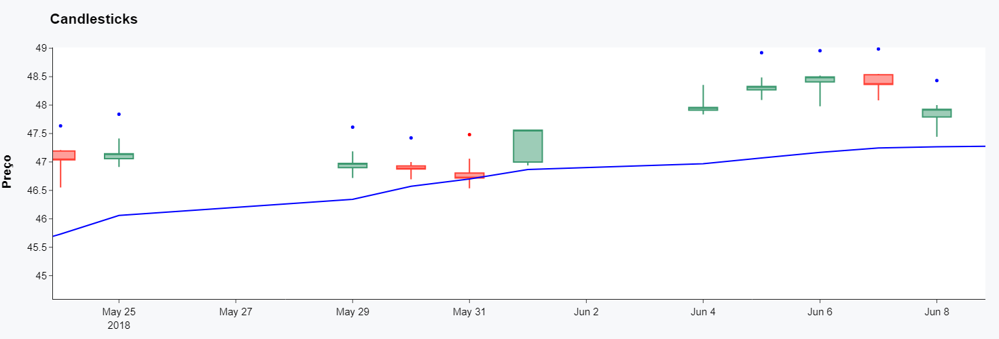

In [8]:
df_figure = dados
fig = make_subplots(rows=1, cols=1)

fig.add_trace(go.Candlestick(name='PETR4', x=df_figure.index, open=df_figure['Open'], high = df_figure['High'], 
                             low=df_figure['Low'], close=df_figure['Close']), row=1,col=1)

fig.add_trace(go.Scatter(name='media_principal', x=df_figure.index, y=df_figure['Media_Principal'], marker_color='blue'), row=1, col=1)
fig.add_trace(go.Scatter(name='media_15m', x=df_figure.index, y=df_figure['Media_15m'], marker_color='red'), row=1, col=1)
fig.add_trace(go.Scatter(name='media_1hr', x=df_figure.index, y=df_figure['Media_1hr'], marker_color='black'), row=1, col=1)
fig.add_trace(go.Scatter(name='tendencia', x=df_figure.index, y=(1 + .009)*df_figure["High"].where(df_figure["Tendencia"] == True), 
mode='markers', marker=dict(color='Blue', size=5)))
fig.add_trace(go.Scatter(name='toque', x=df_figure.index, y=(1 + .009)*df_figure["High"].where(df_figure["Toque"] == True), 
mode='markers', marker=dict(color='Red', size=5)))

#fig.update_xaxes(title_text="<b> Data",rangebreaks=[dict(bounds=["sat", "mon"])])
fig.update_layout(xaxis_rangeslider_visible=False, showlegend=False)
fig.update_layout(xaxis_rangeslider_visible=False, title_text='<b>Candlesticks', 
                  yaxis1_title="<b> Preço",
                  font=dict(family="Arial", size=15, color="black"), margin=dict(l=50, r=20, t=70, b=20),
                  template = 'simple_white', paper_bgcolor="#f7f8fa",
                  width=800, height=500)
fig.show()

## ***Análise estatística***

In [34]:
dados['candles_seguintes_ao_que_tocam'] = dados['Toque'].shift(1) == True

In [35]:
dados['candles_seguintes_ao_que_nao_tocam'] = (dados['Tendencia'].shift(1)==True) & ((dados['Toque'] == False) & (dados['Close'] > dados['Media_Principal']))

#### ***Plot test candles seguintes ao que tocam***

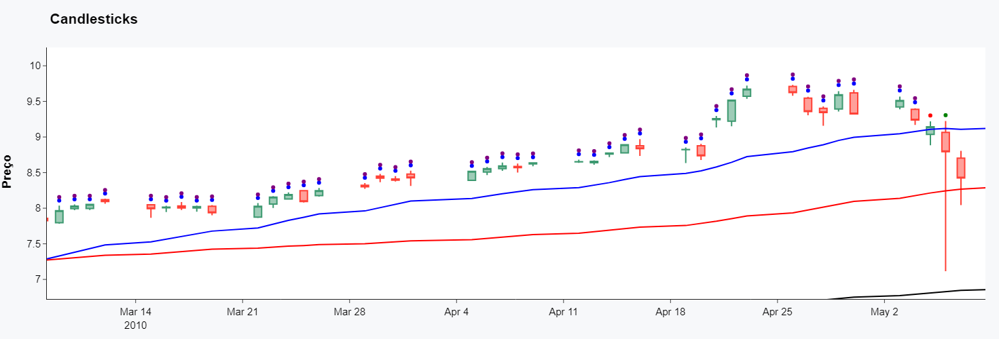

In [30]:
df_figure = dados
fig = make_subplots(rows=1, cols=1)

fig.add_trace(go.Candlestick(name='PETR4', x=df_figure.index, open=df_figure['Open'], high = df_figure['High'], 
                             low=df_figure['Low'], close=df_figure['Close']), row=1,col=1)

fig.add_trace(go.Scatter(name='media_principal', x=df_figure.index, y=df_figure['Media_Principal'], marker_color='blue'), row=1, col=1)
fig.add_trace(go.Scatter(name='media_15m', x=df_figure.index, y=df_figure['Media_15m'], marker_color='red'), row=1, col=1)
fig.add_trace(go.Scatter(name='media_1hr', x=df_figure.index, y=df_figure['Media_1hr'], marker_color='black'), row=1, col=1)
fig.add_trace(go.Scatter(name='tendencia', x=df_figure.index, y=(1 + .009)*df_figure["High"].where(df_figure["Tendencia"] == True), 
mode='markers', marker=dict(color='Blue', size=6)))
fig.add_trace(go.Scatter(name='toque', x=df_figure.index, y=(1 + .009)*df_figure["High"].where(df_figure["Toque"] == True), 
mode='markers', marker=dict(color='Red', size=6)))
fig.add_trace(go.Scatter(name='candles_seguintes_ao_que_tocam', x=df_figure.index, y=(1 + .009)*df_figure["High"].where(df_figure["candles_seguintes_ao_que_tocam"] == True), 
mode='markers', marker=dict(color='Green', size=6)))
fig.add_trace(go.Scatter(name='candles_seguintes_ao_que_nao_tocam', x=df_figure.index, y=(1 + .015)*df_figure["High"].where(df_figure["candles_seguintes_ao_que_nao_tocam"] == True), 
mode='markers', marker=dict(color='Purple', size=6)))
#fig.add_trace(go.Scatter(name='candles_seguintes_ao_que_nao_tocam', x=df_figure.index, y=(1 + .009)*df_figure["High"].where(df_figure["candles_seguintes_ao_que_nao_tocam"] == True), 
#mode='markers', marker=dict(color='Purple', size=5)))
#fig.update_xaxes(title_text="<b> Data",rangebreaks=[dict(bounds=["sat", "mon"])])
fig.update_layout(xaxis_rangeslider_visible=False, showlegend=False)
fig.update_layout(xaxis_rangeslider_visible=False, title_text='<b>Candlesticks', 
                  yaxis1_title="<b> Preço",
                  font=dict(family="Arial", size=15, color="black"), margin=dict(l=50, r=20, t=70, b=20),
                  template = 'simple_white', paper_bgcolor="#f7f8fa",
                  width=800, height=500)
fig.show()

In [51]:
candles_seguintes_ao_que_tocam = dados.loc[dados['candles_seguintes_ao_que_tocam'] == True].copy()
candles_seguintes_ao_que_nao_tocam = dados.loc[dados['candles_seguintes_ao_que_nao_tocam'] == True].copy()

In [61]:
candles_seguintes_ao_que_tocam['Positivo'] = (candles_seguintes_ao_que_tocam['Close'] > candles_seguintes_ao_que_tocam['Open']).astype(int)

In [60]:
candles_seguintes_ao_que_nao_tocam['Positivo'] = (candles_seguintes_ao_que_nao_tocam['Close'] > candles_seguintes_ao_que_nao_tocam['Open']).astype(int)

## ***Resultados***

Candles seguintes ao toque:

In [66]:
(candles_seguintes_ao_que_tocam['Positivo'].sum() / len(candles_seguintes_ao_que_tocam))*100

46.0

Candles seguintes a candles de tendência que não tocam:

In [67]:
(candles_seguintes_ao_que_nao_tocam['Positivo'].sum() / len(candles_seguintes_ao_que_nao_tocam))*100

52.964233219010296